<a href="https://colab.research.google.com/github/tg-bomze/collection-of-notebooks/blob/master/StyleGAN3_train%26test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<b><font color="black" size="+4">StyleGAN3 train/test</font></b>

<b><font color="black" size="+2">Based on:</font></b>

**GitHub repository**: [stylegan3](https://github.com/NVlabs/stylegan3), [CLIP](https://github.com/openai/CLIP)

Colab based on dvschultz's [notebook](https://colab.research.google.com/github/dvschultz/stylegan3/blob/main/SG3.ipynb), crimeacs's [notebook](https://colab.research.google.com/drive/1BXNHZBai-pXtP-ncliouXo_kUiG1Pq7M) and mishin_learning's [notebook](https://colab.research.google.com/drive/1LWWlW40-ZHnyhyJgU6xKaSsl8bwCT1wx).

<b><font color="black" size="+2">Colab created by:</font></b>

GitHub: [@tg-bomze](https://github.com/tg-bomze),
Telegram: [@MLArt](https://t.me/MLArt),
Twitter: [@tg_bomze](https://twitter.com/tg_bomze).

---


```
(ENG) To get started, click on the button (where the red arrow indicates). After clicking, wait until the execution is complete.
```
```
(RUS) Чтобы начать, поочередно нажимайте на кнопки (куда указывают красные стрелки), дожидаясь завершения выполнения каждого блока.
```


In [ ]:
#@title <b><font color="red" size="+3">←</font><font color="black" size="+3"> Check GPU</font></b>
#@markdown <b><font color="black" size="+1"> (RUS) Проверить выданное GPU</font></b>
!nvidia-smi -L

In [ ]:
#@title <b><font color="red" size="+3">←</font><font color="black" size="+3"> Mount Drive and Install all necessary libraries (~3min)</font></b>
#@markdown <b><font color="black" size="+1"> (RUS) Смонировать Гугл Драйв и установить все необходимые библиотеки (~3мин)</font></b>

#@markdown (ENG) `install_CLIP_dependencies` - optional parameter that will take an additional 3 minutes to install

#@markdown (RUS) `install_CLIP_dependencies` - oпциональный параметр, установка которого займет дополнительные 3 минуты
install_CLIP_dependencies = False #@param {type:"boolean"}

from IPython.display import clear_output
from google.colab import drive
drive.mount('/content/drive')

if install_CLIP_dependencies:
  !pip install --upgrade torch==1.9.1+cu111 torchvision==0.10.1+cu111 torchtext>=0.10.0 -f https://download.pytorch.org/whl/torch_stable.html
  !git clone https://github.com/NVlabs/stylegan3
  !git clone https://github.com/openai/CLIP
  !pip install -e ./CLIP
  !pip install einops ninja
  !pip install lpips
  !pip install kornia

  import sys
  sys.path.append('./CLIP')
  sys.path.append('./stylegan3')

  import io
  import os, time
  import pickle
  import shutil
  import kornia.augmentation as K
  import numpy as np
  import math
  from PIL import Image
  import torch
  import torch.nn.functional as F
  import requests
  import torchvision.transforms as transforms
  import torchvision.transforms.functional as TF
  import clip
  from tqdm.notebook import tqdm
  from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
  from IPython.display import display
  from einops import rearrange
  from google.colab import files

  device = torch.device('cuda:0')
  clear_output()

try: 
  !pip3 install googletrans==3.1.0a0
  from googletrans import Translator, constants
  from pprint import pprint
  translator = Translator()
except: pass

!wget -O mini.sh https://repo.anaconda.com/miniconda/Miniconda3-py38_4.8.2-Linux-x86_64.sh
!chmod +x mini.sh
!bash ./mini.sh -b -f -p /usr/local
!conda install -q -y --prefix /usr/local jupyter
!python -m ipykernel install --name "py38" --user
!pip install click -q
!pip install numpy -q
!pip install pillow -q
!pip install torch -q
!pip install scipy -q
!pip install imageio -q
!pip install psutil -q
!pip install tensorboard -q
!pip install imageio-ffmpeg -q
!pip install Ninja -q
clear_output()

import matplotlib.pyplot as plt
from PIL import Image

import os
if os.path.isdir("/content/drive/MyDrive/stylegan3_colab"):
    %cd /content/drive/MyDrive/stylegan3_colab/stylegan3
elif os.path.isdir("/content/drive/"):
    %cd /content/drive/MyDrive
    !mkdir stylegan3_colab
    %cd stylegan3_colab
    !git clone https://github.com/dvschultz/stylegan3
    !mkdir dataset
    %cd stylegan3
    !mkdir downloads datasets pretrained
else:
    print('Mount Google Drive')

clear_output()
print('Done!')

*(ENG) If you just want to test, then the "Train" section can be skipped.*

*(RUS) Если хочется только протестировать, то раздел "Тренировка" можно пропустить.*

#<b><font color="black" size="+4"> Train (Тренировка)</font></b>


**(ENG) Click on the link below to open the file manager.**

**(RUS) Нажмите на ссылку ниже, чтобы открыть файловый менеджер.**

> /content/drive/MyDrive/stylegan3_colab 

In [ ]:
#@title <b><font color="red" size="+3">←</font><font color="black" size="+3"> Create Dataset</font></b>
#@markdown <b><font color="black" size="+1"> (RUS) Сформировать датасет</font></b>

#@markdown (ENG) Open Google Drive and put the pictures in the folder specified in `input_path_to_images` or specify your own path.

#@markdown (RUS) Откройте Гугл Драйв и положите картинки в папку, указанную в `input_path_to_images` или укажите свой путь.
from tqdm import tqdm
input_path_to_images = "/content/drive/MyDrive/stylegan3_colab/dataset" #@param {type:"string"}

img_size = 1024 #@param ["1024", "512", "256"]
for i in tqdm(os.listdir(input_path_to_images)):
  try:
    img = Image.open(input_path_to_images+i)
    w, h = img.size
    if w > h: img = img.crop((int((w-h)/2), 0, w-int((w-h)/2), h))
    elif h > w: img = img.crop((0, int((h-w)/2), w, h-int((h-w)/2)))
    img = img.resize((img_size,img_size), Image.ANTIALIAS)
    img.save(input_path_to_images+i)
  except: pass

output_name_of_zip = "sculpt-1024.zip" #@param {type:"string"}
data = f'./datasets/{output_name_of_zip}'

!python dataset_tool.py --source=$input_path_to_images --dest=$data

In [ ]:
#@title <b><font color="red" size="+3">←</font><font color="black" size="+3"> Choose parameters and start train</font></b>
#@markdown <b><font color="black" size="+1"> (RUS) Установить параметры и запустить тренировку</font></b>
data_zip = "sculpt-1024.zip" #@param {type:"string"}
data = f'./datasets/{data_zip}'

#@markdown - For an `A100` you can use a `batch_gpu=8`.
#@markdown - For an `V100` and `P100` you can use a `batch_gpu=4`.
#@markdown - For other GPUs `batch_gpu=2`.
batch_gpu = "4" #@param ["8", "4", "2"]
batch_gpu = int(batch_gpu)

kimg = 5000 #@param {type:"integer"}

model_name = "stylegan3-t-ffhq-1024x1024.pkl" #@param ["stylegan3-r-afhqv2-512x512.pkl", "stylegan3-r-ffhq-1024x1024.pkl", "stylegan3-r-ffhqu-1024x1024.pkl","stylegan3-r-ffhqu-256x256.pkl","stylegan3-r-metfaces-1024x1024.pkl","stylegan3-r-metfacesu-1024x1024.pkl","stylegan3-t-afhqv2-512x512.pkl","stylegan3-t-ffhq-1024x1024.pkl","stylegan3-t-ffhqu-1024x1024.pkl","stylegan3-t-ffhqu-256x256.pkl","stylegan3-t-metfaces-1024x1024.pkl","stylegan3-t-metfacesu-1024x1024.pkl", "empty_model", "saved_model"]
img_size_for_empty_model = 1024 #@param ["1024", "512", "256"]
if model_name == "empty_model":
  !git clone https://github.com/aydao/stylegan2-surgery.git
  %cd /content/stylegan2-surgery
  !python create_initial_network_pkl.py --width $wh_img --height $img_size_for_empty_model
  %cd /content/drive/MyDrive/stylegan3_colab/stylegan3
  weight = f"/content/stylegan2-surgery/network-initial-config-f-{img_size_for_empty_model}x{img_size_for_empty_model}-0.pkl"
elif model_name == "saved_model":
  model_path_for_saved_model = "" #@param {type:"string"}
  weight = model_path_for_saved_model
else:
  base_url = "https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/"
  weight = base_url + model_name

config = "(r) translation and rotation" #@param ["(t) translation", "(r) translation and rotation"]
if config == "(t) translation": conf = 'stylegan3-t'
else: conf = 'stylegan3-r'

batch = 32 #@param {type:"integer"}

gamma = 10.0 #@param {type:"number"}

num_gpu = 1 #@param {type:"slider", min:1, max:8, step:1}

#@markdown (ENG) More information about configurations [here](https://github.com/dvschultz/stylegan3/blob/main/docs/configs.md)

#@markdown (RUS) Больше информации о конфигурациях по [ссылке](https://github.com/dvschultz/stylegan3/blob/main/docs/configs.md)

%cd /content/drive/MyDrive/stylegan3_colab/stylegan3
#!python train.py --help
!python train.py --outdir=./results \
  --cfg=$conf \
  --data=$data \
  --gpus=$num_gpu --batch=$batch \
  --batch-gpu=$batch_gpu --gamma=$gamma \
  --mirror=1 --kimg=$kimg --snap=1 \
  --resume=$weight \
  --metrics=None

#<b><font color="black" size="+4"> Test (Тестирование)</font></b>

**(ENG) Next if you click on the link below you can find the results of your training. There are pictures with samples and the weights with the extension ".pkl". Right click on the weight file and select "Copy Path"**

**(RUS) Далее по ссылке ниже вы сможете найти результаты ваших тренировок. Там находятся картинки с сэмплами и сами веса с расширением ".pkl". Нажмите по файлу с весом правой кнопкой мыши и выберите "Скопировать путь"**

> /content/drive/MyDrive/stylegan3_colab/stylegan3/results

Loading networks from "/content/drive/MyDrive/stylegan3_colab/stylegan3/results/00000-stylegan3-r-sculpt-1024-gpus1-batch32-gamma10/network-snapshot-000012.pkl"...
Generating image for seed 670 (0/1) ...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "filtered_lrelu_plugin"... Done.


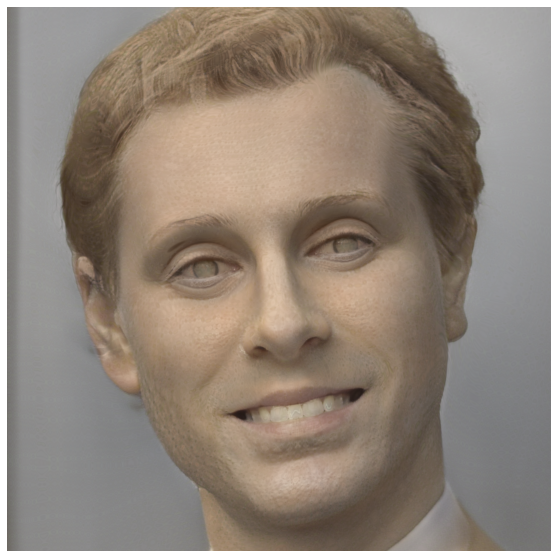

In [ ]:
#@title <b><font color="red" size="+3">←</font><font color="black" size="+3"> Generate Image (first run ~1.5min)</font></b>
#@markdown <b><font color="black" size="+1"> (RUS) Сгенерировать изображение (первый запуск ~1.5мин)</font></b>

model_name = "saved_model" #@param ["stylegan3-r-afhqv2-512x512.pkl", "stylegan3-r-ffhq-1024x1024.pkl", "stylegan3-r-ffhqu-1024x1024.pkl","stylegan3-r-ffhqu-256x256.pkl","stylegan3-r-metfaces-1024x1024.pkl","stylegan3-r-metfacesu-1024x1024.pkl","stylegan3-t-afhqv2-512x512.pkl","stylegan3-t-ffhq-1024x1024.pkl","stylegan3-t-ffhqu-1024x1024.pkl","stylegan3-t-ffhqu-256x256.pkl","stylegan3-t-metfaces-1024x1024.pkl","stylegan3-t-metfacesu-1024x1024.pkl", "saved_model"]
if model_name == "saved_model":
  model_path_for_saved_model = "/content/drive/MyDrive/stylegan3_colab/stylegan3/results/00000-stylegan3-r-sculpt-1024-gpus1-batch32-gamma10/network-snapshot-000012.pkl" #@param {type:"string"}
  weight = model_path_for_saved_model
else:
  base_url = "https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/"
  weight = base_url + model_name

seed = 0 #@param {type:"integer"}
seed = abs(seed)
if seed == 0:
    seed = np.random.randint(0, 9e9)

#!python gen_images.py --help
!python gen_images.py --outdir=out --trunc=1 \
 --seeds=$seed --network=$weight

plt.figure(figsize=(10,10))
img = Image.open('/content/drive/MyDrive/stylegan3_colab/stylegan3/out/seed%04d.png' % seed);
plt.imshow(img);
plt.axis('off');

In [ ]:
#@title <b><font color="red" size="+3">←</font><font color="black" size="+3"> Generate an interpolation video</font></b>
#@markdown <b><font color="black" size="+1"> (RUS) Сгенерировать видео с интерполяцией</font></b>

model_name = "saved_model" #@param ["stylegan3-r-afhqv2-512x512.pkl", "stylegan3-r-ffhq-1024x1024.pkl", "stylegan3-r-ffhqu-1024x1024.pkl","stylegan3-r-ffhqu-256x256.pkl","stylegan3-r-metfaces-1024x1024.pkl","stylegan3-r-metfacesu-1024x1024.pkl","stylegan3-t-afhqv2-512x512.pkl","stylegan3-t-ffhq-1024x1024.pkl","stylegan3-t-ffhqu-1024x1024.pkl","stylegan3-t-ffhqu-256x256.pkl","stylegan3-t-metfaces-1024x1024.pkl","stylegan3-t-metfacesu-1024x1024.pkl", "saved_model"]
if model_name == "saved_model":
  model_path_for_saved_model = "/content/drive/MyDrive/stylegan3_colab/stylegan3/results/00000-stylegan3-r-sculpt-1024-gpus1-batch32-gamma10/network-snapshot-000012.pkl" #@param {type:"string"}
  weight = model_path_for_saved_model
else:
  base_url = "https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/"
  weight = base_url + model_name

start_seed = 42 #@param {type:"integer"}
stop_seed = 69 #@param {type:"integer"}
n_cols = 1 #@param {type:"integer"}
n_rows = 1 #@param {type:"integer"}

#@markdown How many key frames to have?
num_keyframes =  10#@param {type:"integer"}
num_keyframes = abs(num_keyframes)

#@markdown How many frames for interpolation?
w_frames = 60 #@param {type:"integer"}
w_frames = abs(w_frames)

#@markdown Total length in frames is `num_keyframes`*`w_frames`

assert stop_seed > start_seed, 'Stop_seed should be larger then start_seed'


#!python gen_video.py --help
!python gen_video.py --output=lerp.mp4 --trunc=1 --seeds=$start_seed-$stop_seed --grid={n_rows}x{n_cols} \
    --network=$weight --num-keyframes=$num_keyframes \
    --w-frames=$w_frames


from IPython.display import HTML
from base64 import b64encode
mp4 = open('lerp.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

Loading networks from "/content/drive/MyDrive/stylegan3_colab/stylegan3/results/00000-stylegan3-r-sculpt-1024-gpus1-batch32-gamma10/network-snapshot-000016.pkl"...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "filtered_lrelu_plugin"... Done.
100% 600/600 [01:19<00:00,  7.58it/s]


#<b><font color="black" size="+4"> Bonus: CLIP (Бонус: CLIP)</font></b>

**(ENG) If you have not set the `install_CLIP_dependencies` parameter, then click "Runtime > Reset Runtime" and run the first block again.**

**(RUS) Если вы не установили параметр `install_CLIP_dependencies`, то нажмите "Среда выполнения > Сбросить среду выполнения" и выполните первый блок заново.**

In [ ]:
#@title <b><font color="red" size="+3">←</font><font color="black" size="+3"> Declare additional functions</font></b>
#@markdown <b><font color="black" size="+1"> (RUS) Объявить дополнительные функции</font></b>
def fetch(url_or_path):
    if str(url_or_path).startswith('http://') or str(url_or_path).startswith('https://'):
        r = requests.get(url_or_path)
        r.raise_for_status()
        fd = io.BytesIO()
        fd.write(r.content)
        fd.seek(0)
        return fd
    return open(url_or_path, 'rb')

def fetch_model(url_or_path):
    basename = os.path.basename(url_or_path)
    if os.path.exists(basename):
        return basename
    else:
        !wget -c '{url_or_path}'
        return basename

def norm1(prompt):
    "Normalize to the unit sphere."
    return prompt / prompt.square().sum(dim=-1,keepdim=True).sqrt()

def spherical_dist_loss(x, y):
    x = F.normalize(x, dim=-1)
    y = F.normalize(y, dim=-1)
    return (x - y).norm(dim=-1).div(2).arcsin().pow(2).mul(2)

def sinc(x):
    return torch.where(x != 0, torch.sin(math.pi * x) / (math.pi * x), x.new_ones([]))

def lanczos(x, a):
    cond = torch.logical_and(-a < x, x < a)
    out = torch.where(cond, sinc(x) * sinc(x/a), x.new_zeros([]))
    return out / out.sum()

def ramp(ratio, width):
    n = math.ceil(width / ratio + 1)
    out = torch.empty([n])
    cur = 0
    for i in range(out.shape[0]):
        out[i] = cur
        cur += ratio
    return torch.cat([-out[1:].flip([0]), out])[1:-1]

def resample(input, size, align_corners=True):
    n, c, h, w = input.shape
    dh, dw = size

    input = input.view([n * c, 1, h, w])

    if dh < h:
        kernel_h = lanczos(ramp(dh / h, 2), 2).to(input.device, input.dtype)
        pad_h = (kernel_h.shape[0] - 1) // 2
        input = F.pad(input, (0, 0, pad_h, pad_h), 'reflect')
        input = F.conv2d(input, kernel_h[None, None, :, None])

    if dw < w:
        kernel_w = lanczos(ramp(dw / w, 2), 2).to(input.device, input.dtype)
        pad_w = (kernel_w.shape[0] - 1) // 2
        input = F.pad(input, (pad_w, pad_w, 0, 0), 'reflect')
        input = F.conv2d(input, kernel_w[None, None, None, :])

    input = input.view([n, c, h, w])
    return F.interpolate(input, size, mode='bicubic', align_corners=align_corners)

class MakeCutouts(torch.nn.Module):
    def __init__(self, cut_size, cutn, cut_pow=1.):
        super().__init__()
        self.cut_size = cut_size
        self.cutn = cutn
        self.cut_pow = cut_pow
        self.augs = torch.nn.Sequential(
            K.RandomHorizontalFlip(p=0.5),
            K.RandomSharpness(0.3,p=0.4),
            K.RandomAffine(degrees=7, translate=0.05, p=0.7, padding_mode='border'),
            K.RandomPerspective(0.3, p=0.5),
            K.ColorJitter(hue=0.01, saturation=0.01, p=0.7))
        self.noise_fac = 0.1


    def forward(self, input):
        sideY, sideX = input.shape[2:4]
        max_size = min(sideX, sideY)
        min_size = min(sideX, sideY, self.cut_size)
        cutouts = []
        for _ in range(self.cutn):
            size = int(torch.rand([])**self.cut_pow * (max_size - min_size) + min_size)
            offsetx = torch.randint(0, sideX - size + 1, ())
            offsety = torch.randint(0, sideY - size + 1, ())
            cutout = input[:, :, offsety:offsety + size, offsetx:offsetx + size]
            # cutouts.append(resample(cutout, (self.cut_size, self.cut_size)))
            cutouts.append(F.adaptive_avg_pool2d(cutout, self.cut_size))
        batch = self.augs(torch.cat(cutouts, dim=0))
        if self.noise_fac:
            facs = batch.new_empty([self.cutn, 1, 1, 1]).uniform_(0, self.noise_fac)
            batch = batch + facs * torch.randn_like(batch)
        return batch

make_cutouts = MakeCutouts(224, 42, 0.25)

def embed_image(image):
  n = image.shape[0]
  cutouts = make_cutouts(image)
  embeds = clip_model.embed_cutout(cutouts)
  embeds = rearrange(embeds, '(cc n) c -> cc n c', n=n)
  return embeds

def embed_url(url):
  image = Image.open(fetch(url)).convert('RGB')
  return embed_image(TF.to_tensor(image).to(device).unsqueeze(0)).mean(0).squeeze(0)

class CLIP(object):
  def __init__(self):
    clip_model = "ViT-B/32"
    self.model, _ = clip.load(clip_model)
    self.model = self.model.requires_grad_(False)
    self.normalize = transforms.Normalize(mean=[0.48145466, 0.4578275, 0.40821073],
                                          std=[0.26862954, 0.26130258, 0.27577711])

  @torch.no_grad()
  def embed_text(self, prompt):
      "Normalized clip text embedding."
      return norm1(self.model.encode_text(clip.tokenize(prompt).to(device)).float())

  def embed_cutout(self, image):
      "Normalized clip image embedding."
      return norm1(self.model.encode_image(self.normalize(image)))

clip_model = CLIP()
clear_output()

  0%|          | 0/100 [00:00<?, ?it/s]

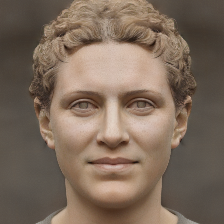

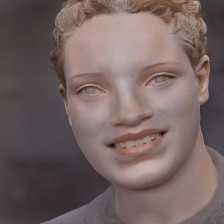

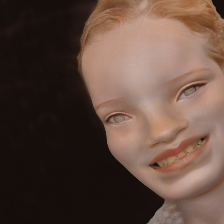

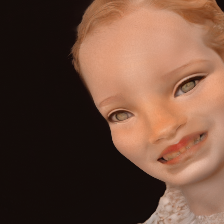

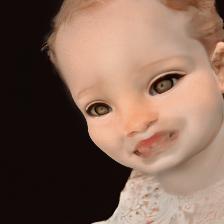

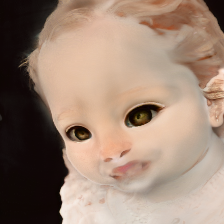

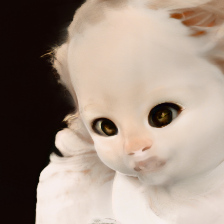

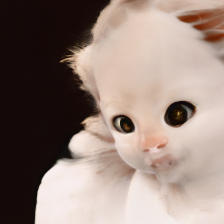

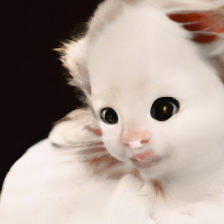

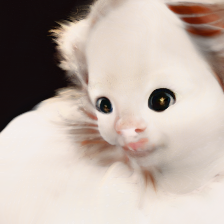

In [ ]:
#@title <b><font color="red" size="+3">←</font><font color="black" size="+3"> Choose parameters & Generate image</font></b>
#@markdown <b><font color="black" size="+1"> (RUS) Установить параметры и запустить генерацию</font></b>
import numpy as np

model_name = "saved_model" #@param ["stylegan3-r-afhqv2-512x512.pkl", "stylegan3-r-ffhq-1024x1024.pkl", "stylegan3-r-ffhqu-1024x1024.pkl","stylegan3-r-ffhqu-256x256.pkl","stylegan3-r-metfaces-1024x1024.pkl","stylegan3-r-metfacesu-1024x1024.pkl","stylegan3-t-afhqv2-512x512.pkl","stylegan3-t-ffhq-1024x1024.pkl","stylegan3-t-ffhqu-1024x1024.pkl","stylegan3-t-ffhqu-256x256.pkl","stylegan3-t-metfaces-1024x1024.pkl","stylegan3-t-metfacesu-1024x1024.pkl", "saved_model"]
if model_name == "saved_model":
  model_path_for_saved_model = "/content/drive/MyDrive/stylegan3_colab/stylegan3/results/00000-stylegan3-r-sculpt-1024-gpus1-batch32-gamma10/network-snapshot-000012.pkl" #@param {type:"string"}
  network_url = model_path_for_saved_model
else:
  base_url = "https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/"
  weight = base_url + model_name
  network_url = fetch_model(weight)

with open(network_url, 'rb') as fp:
  G = pickle.load(fp)['G_ema'].to(device)

#@markdown Do you want to fix the coordinate grid?
fix_coordinates = "False" #@param ["True", "False"]

if fix_coordinates == "True":
    shift = G.synthesis.input.affine(G.mapping.w_avg.unsqueeze(0))
    G.synthesis.input.affine.bias.data.add_(shift.squeeze(0))
    G.synthesis.input.affine.weight.data.zero_()

zs = torch.randn([10000, G.mapping.z_dim], device=device)
w_stds = G.mapping(zs, None).std(0) #.std(0)


#@markdown Enter your text prompt or link to image here:
text_or_image_link = 'https://img5.goodfon.ru/original/2048x2048/5/d9/kotenok-belyi-malysh-vzgliad.jpg' #@param {type:"string"}
if text_or_image_link[0:4] == 'http': 
  target = embed_url(text_or_image_link)
else:
  try:
    from googletrans import Translator, constants
    from pprint import pprint
    translator = Translator()
    translation = translator.translate(text)
    new_text = translation.text
  except: new_text = text
  target = clip_model.embed_text(new_text)

#@markdown How many steps should it be doing?
steps =  100#@param 

## @markdown Choose random seed (-1 for completly random)
seed =  -1 
seed = int(seed)
if seed == -1:
    seed = np.random.randint(0, 9e9)
    
##@markdown How often do you want to see the results?
show_every_n_steps =  10

#@title Generate image
from IPython.display import display

tf = Compose([
  Resize(224),
  lambda x: torch.clamp((x+1)/2,min=0,max=1),
  ])


torch.manual_seed(seed)
timestring = time.strftime('%Y%m%d%H%M%S')
q = (G.mapping(torch.randn([1, G.mapping.z_dim], device=device), None, truncation_psi=0.2) - G.mapping.w_avg) / w_stds
q.requires_grad_()

w_ema = torch.zeros([1, 16, 512]).to(device)
opt = torch.optim.AdamW([q], lr=0.03, betas=(0.8, 0.9))
loop = tqdm(range(steps))
for i in loop:
    opt.zero_grad()
    w = q * w_stds
    image = G.synthesis(w + G.mapping.w_avg, noise_mode='const')
    embed = embed_image(image.add(1).div(2))
    loss = spherical_dist_loss(embed, target).mean()
    loss.backward()
    opt.step()
    loop.set_postfix(loss=loss.item(), q_magnitude=q.std().item())

    w_ema = w_ema * 0.5 + w * 0.5
    image = G.synthesis(w_ema + G.mapping.w_avg, noise_mode='const')

    if i % show_every_n_steps == 0:
        display(TF.to_pil_image(tf(image)[0]))
    pil_image = TF.to_pil_image(image[0].add(1).div(2).clamp(0,1))
    os.makedirs(f'samples/{timestring}', exist_ok=True)
    pil_image.save(f'samples/{timestring}/{i:04}.png')

In [ ]:
#@title <b><font color="red" size="+3">←</font><font color="black" size="+3"> Creating a video</font></b>
#@markdown <b><font color="black" size="+1"> (RUS) Создать видео</font></b>

from IPython import display
from base64 import b64encode


init_frame =   0#@param 
last_frame = 100#@param

min_fps = 10
max_fps = 30

length = 11 #Desired time of the video in seconds

frames = []
tqdm.write('Generating video...')
for i in sorted(os.listdir(f'samples/{timestring}')): #
    frames.append(Image.open(f"samples/{timestring}/{i}"))
frames = frames[init_frame:last_frame]
total_frames = len(frames)

fps = np.clip(total_frames/length,min_fps,max_fps)
fps = 20 #@param
from subprocess import Popen, PIPE
p = Popen(['ffmpeg', '-y', '-f', 'image2pipe', '-vcodec', 'png', '-r', str(fps), '-i', '-', '-vcodec', 'libx264', '-r', str(fps), '-pix_fmt', 'yuv420p', '-crf', '17', '-preset', 'veryslow', 'video.mp4'], stdin=PIPE)
for im in tqdm(frames):
    im.save(p.stdin, 'PNG')
p.stdin.close()
p.wait()
mp4 = open('video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
display.HTML("""
<video width=640 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

Generating video...


  0%|          | 0/100 [00:00<?, ?it/s]